In [1]:
#imports

import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.path import Path
import matplotlib.patches as patches


import glob

from IPython.display import Image
from IPython.display import display

from scipy.ndimage import gaussian_filter1d
from scipy import signal

%matplotlib inline

#import folders consisting of images for calibration and test images
cal_images = glob.glob('camera_cal/calibration*.jpg')
test_images = glob.glob('test_images/test*.jpg') 


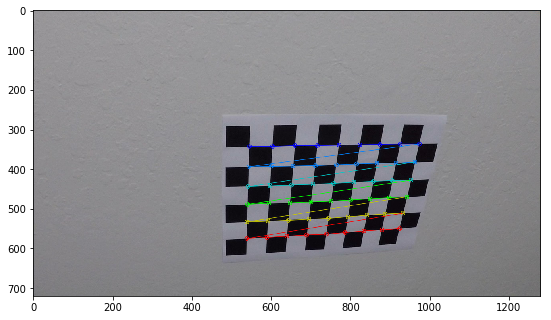

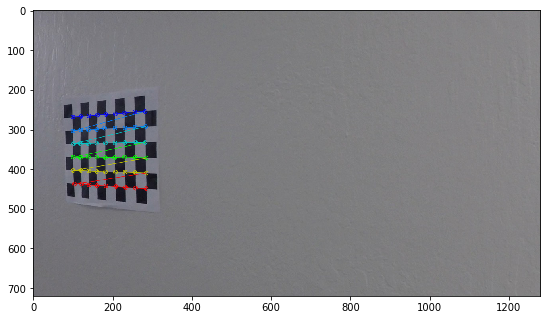

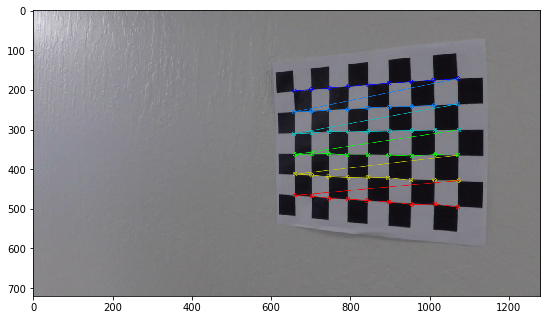

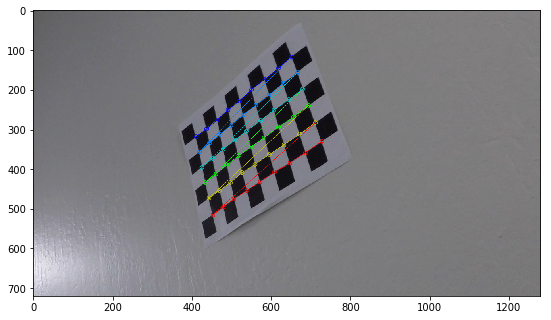

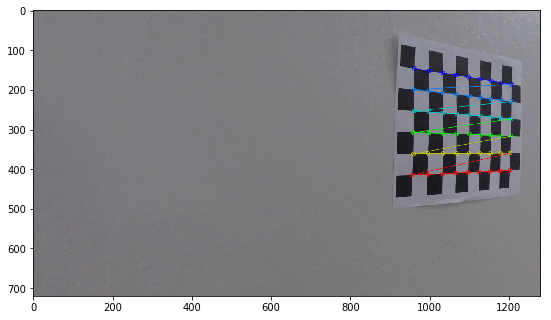

...

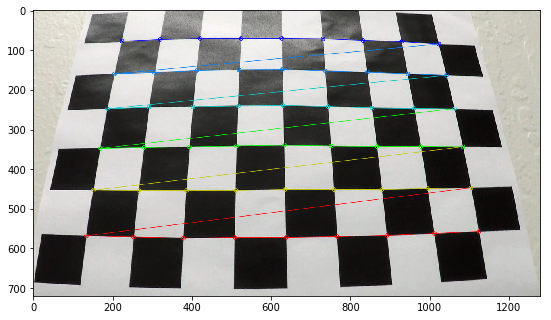

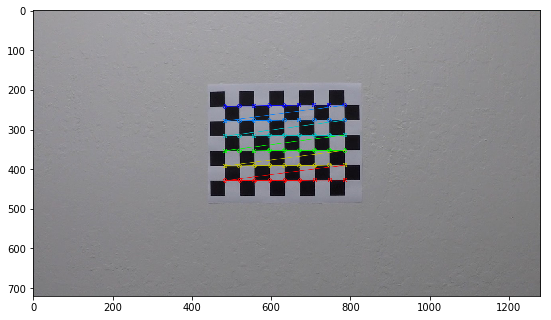

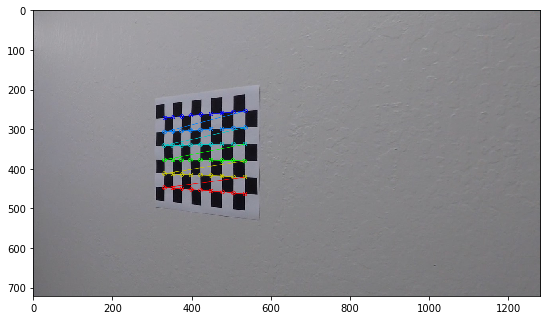

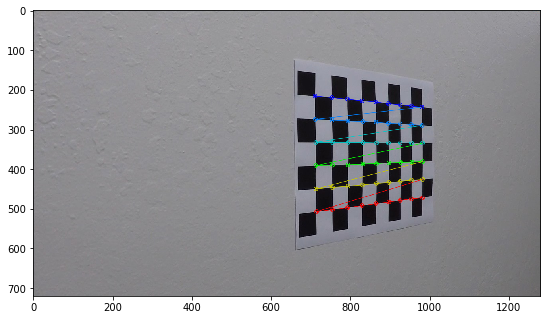

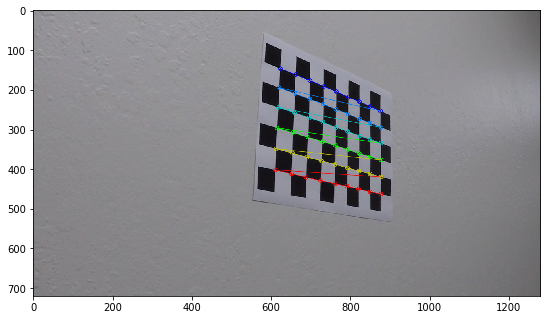

In [2]:


#----------CALIBRATION----------------#
#object points for calibration
x_objpoints = 9
y_objpoints = 6

#object points and image points array. These arrays will be appended to as calibration images are being read.
objpoints = []
imgpoints = []

#prepare object points
objp = np.zeros((x_objpoints * y_objpoints, 3), np.float32)
objp[:,:2] = np.mgrid[0:x_objpoints, 0:y_objpoints].T.reshape(-1,2)

#go through every image in calibration images
for file in cal_images:
    
    #1. Read an Image
    image = mpimg.imread(file)
    
    #2. Convert image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    #3. Find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (x_objpoints, y_objpoints), None)

    #if all the corners were found
    if (ret == True):
        
        #append object points and image points accross all callibration images to reduce the likely hood of error.
        objpoints.append(objp)
        imgpoints.append(corners)

        #4. drawy chessboard corners on each image
        image = cv2.drawChessboardCorners(image,  (x_objpoints, y_objpoints), corners, ret)
        fig = plt.figure(figsize = (20,20))
        ax1 = fig.add_subplot(1,2,1)
        ax1.imshow(image)


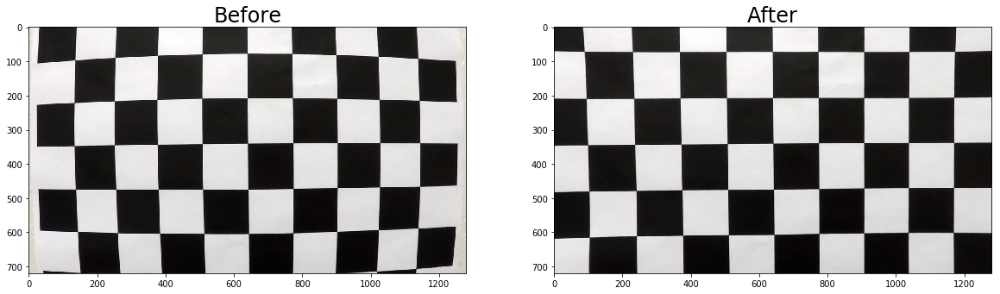

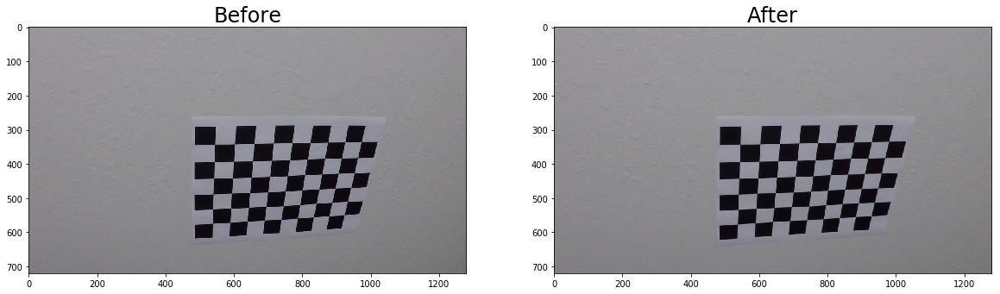

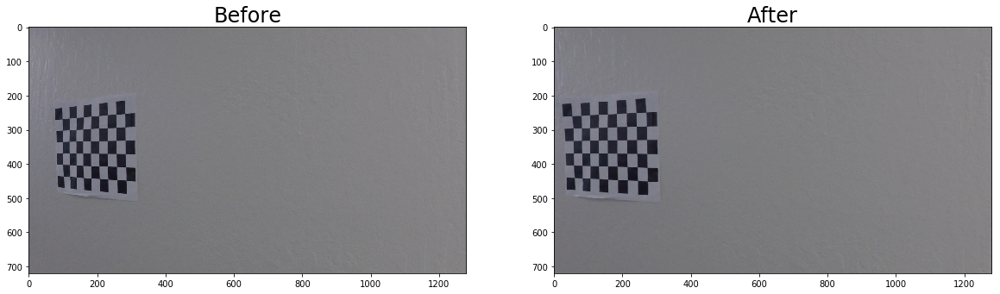

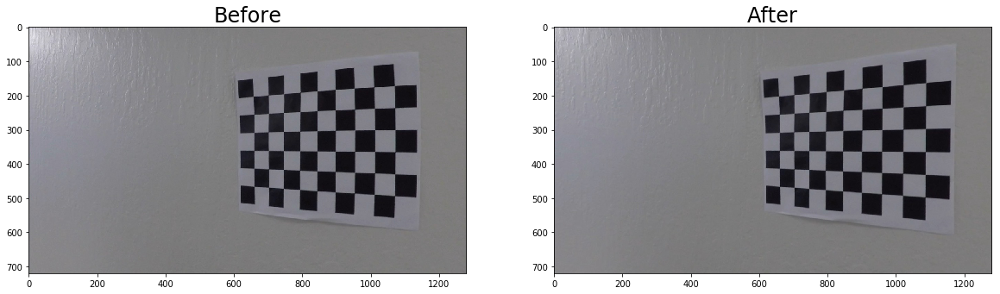

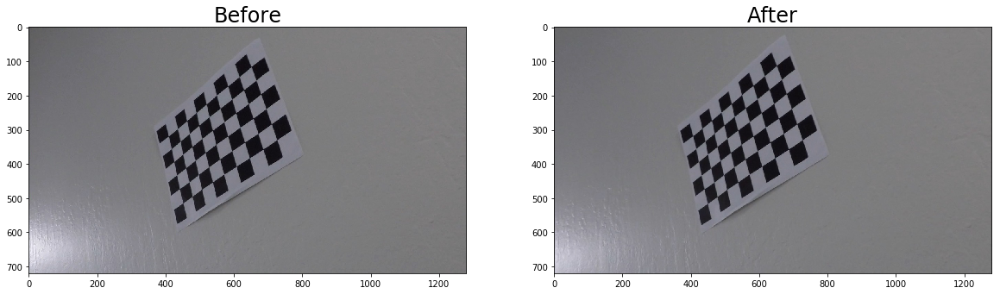

...

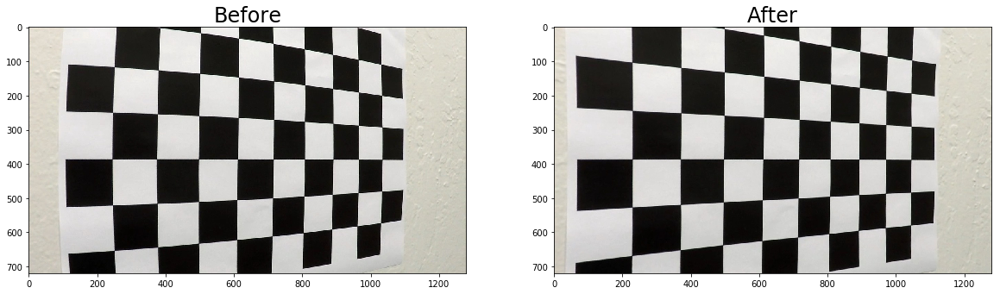

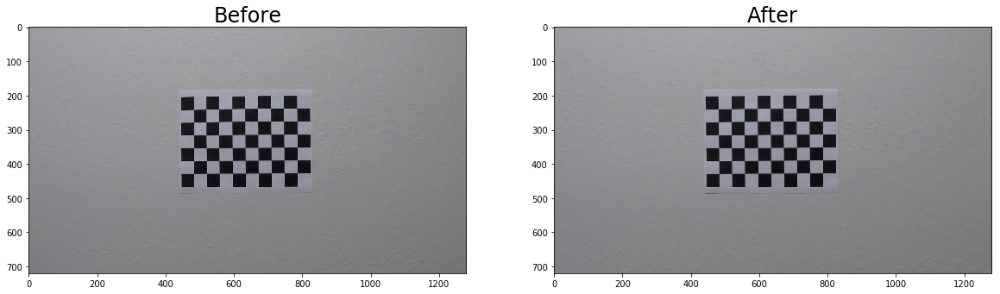

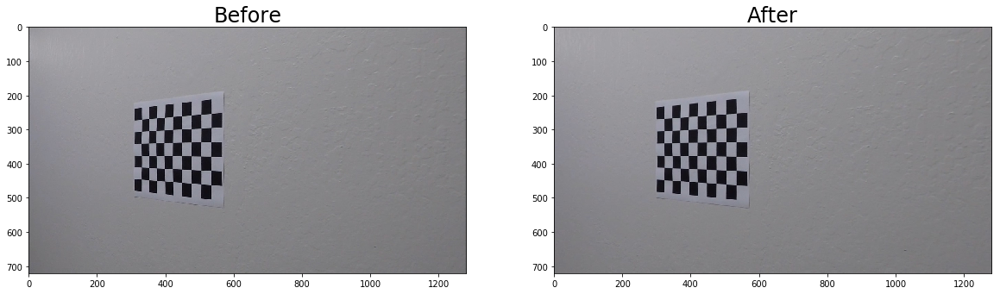

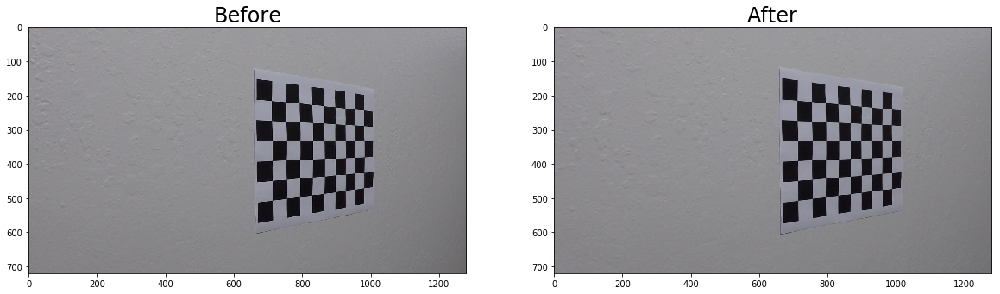

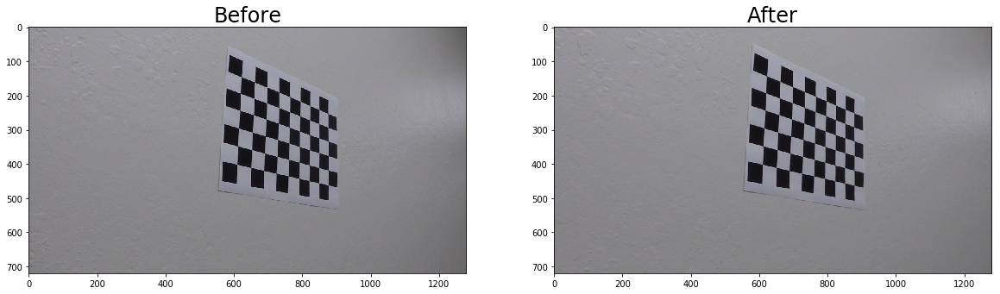

In [3]:
#We now have the object points and image points. These can be used to calculate the camera matrix and distortion coefficients.
#-----------------------UNDISTORING IMAGES ------------------------------------------------

# undistort_values function returns the camera matrix and distortion matrix values
def undistort_values(image, objpoints, imgpoints):
    
    #convert image to grayscale
    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    
    #use the calibrateCamera function on objpoints and imgpoints array. This will return the camera matrix and distoriton matrix.
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    
    #return camera matrix and distorntion matrix
    return mtx, dist

#use undistort_values function to calculate camera matrix and distortion matrix to be used accross all frames
image = mpimg.imread(cal_images[0])

# _mtx and _dist are the camera matrix and distortion values that will be used to undistort all images
_mtx, _dist = undistort_values(image, objpoints, imgpoints)

#undistort_image applies the camera matrix and distortion matrix values to a given image
def undistort_image(image, mtx = _mtx, dist = _dist):
    
    #undistort image by using the predetermined camera matrix and distortion matrix values
    undist_image = cv2.undistort(image, mtx, dist, None, None)
    
    #return undistorted image
    return undist_image

#We can test our result out of camera matrix and distortion matrix values by passing in each chessboard image and 
#comparing these images before and after the distortion algorithm has been applied onto them.
for file in cal_images:
    
    #load the image into memory
    image = mpimg.imread(file)
    
    #undistort the image
    undistorted = undistort_image(image)
    
    fig = plt.figure(figsize = (20,20))
    ax1 = fig.add_subplot(1,2,1)
    ax1.imshow(image)
    ax1.set_title('Before', fontsize = 24)
    ax2 = fig.add_subplot(1,2,2)
    ax2.imshow(undistorted)
    ax2.set_title('After', fontsize = 24)


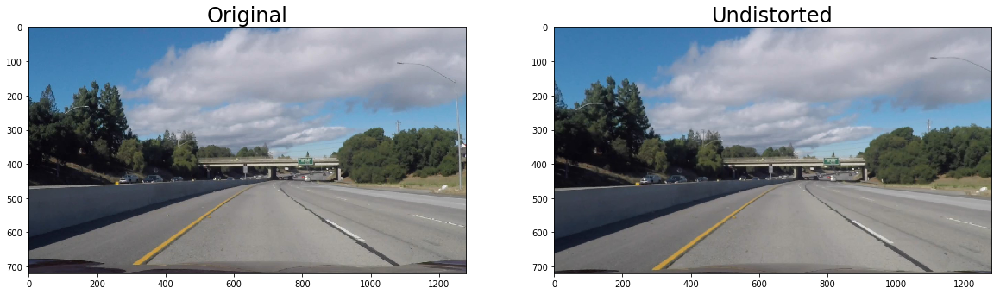

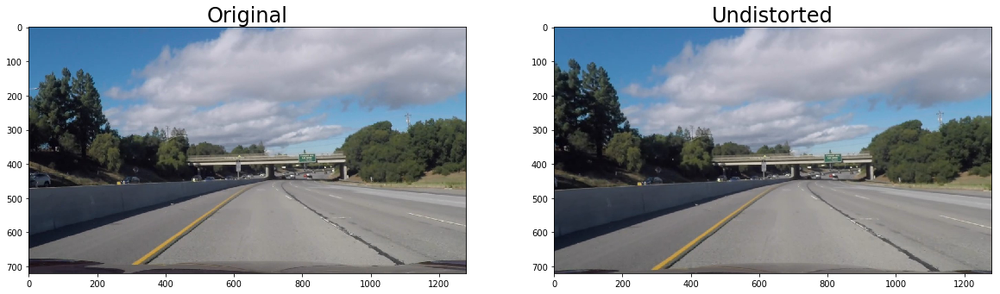

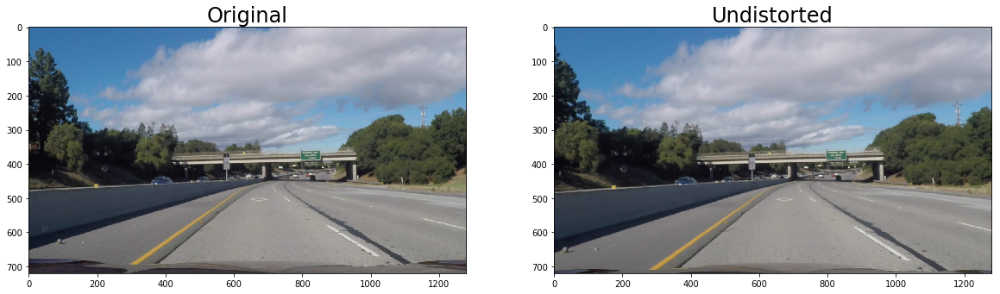

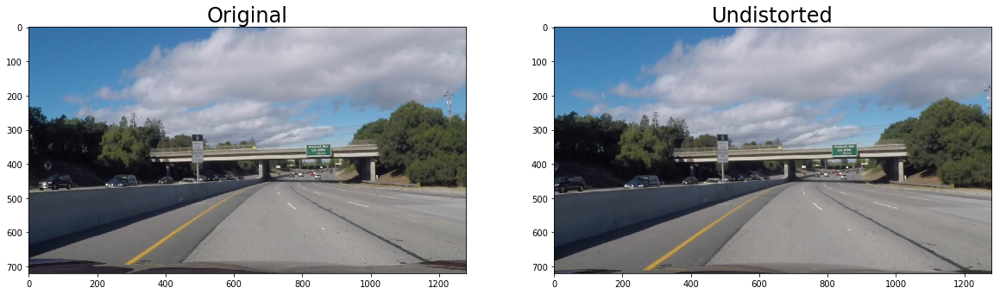

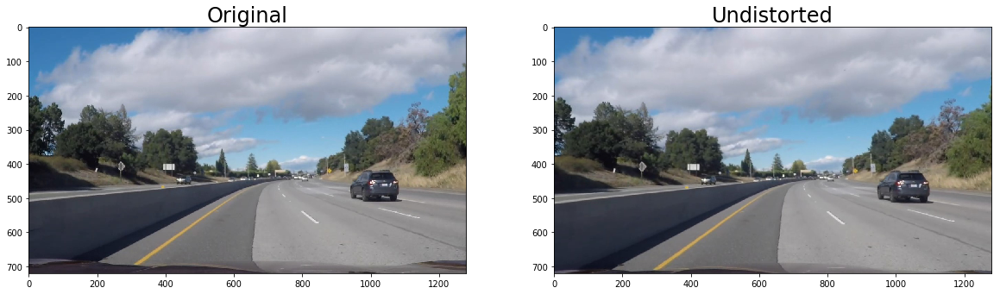

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


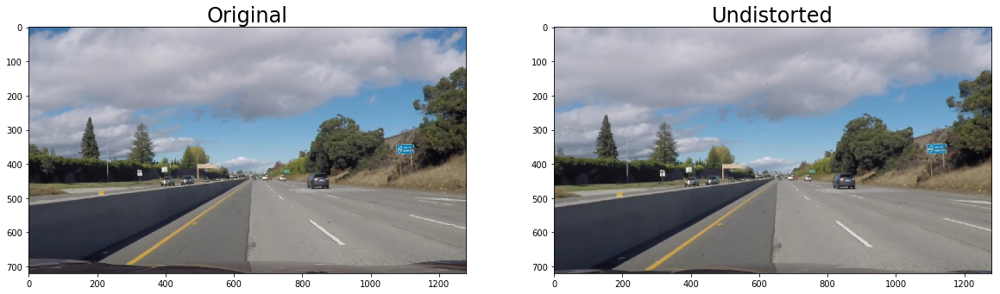

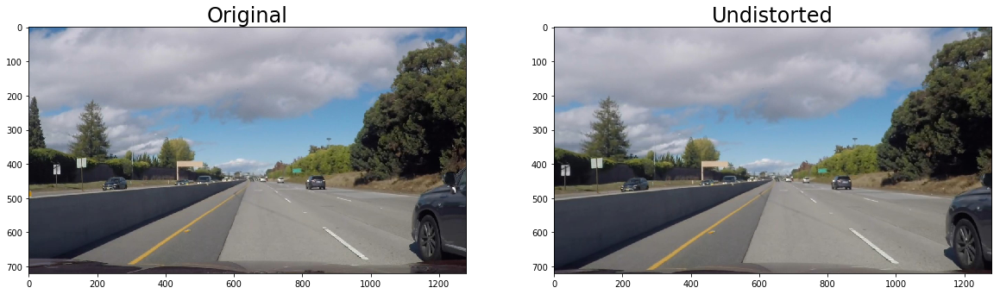

In [4]:
#undistort test images
for file in test_images:
    image = mpimg.imread(file)
    undistorted = undistort_image(image)
    
    
    fig = plt.figure(figsize = (20,20))
    ax1 = fig.add_subplot(1,2,1)
    ax1.imshow(image)
    ax1.set_title('Original', fontsize = 24)
    ax2 = fig.add_subplot(1,2,2)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted', fontsize = 24)

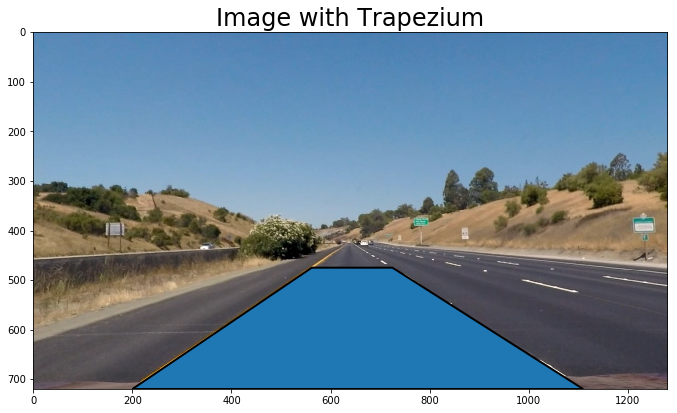

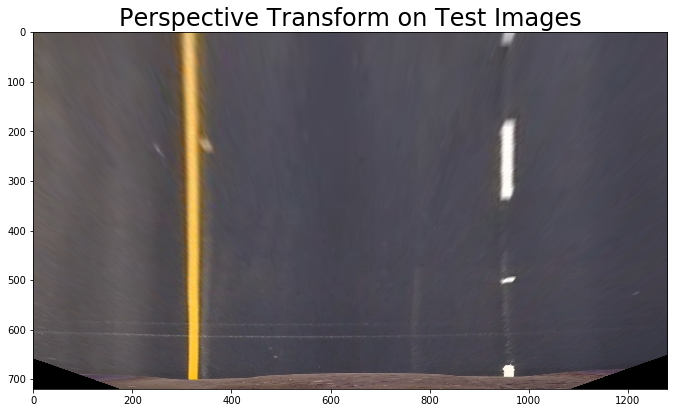

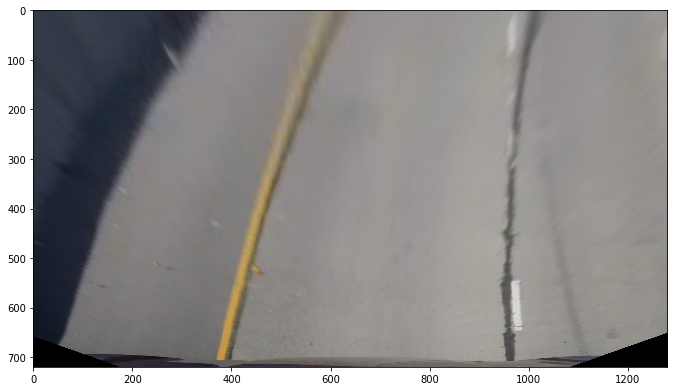

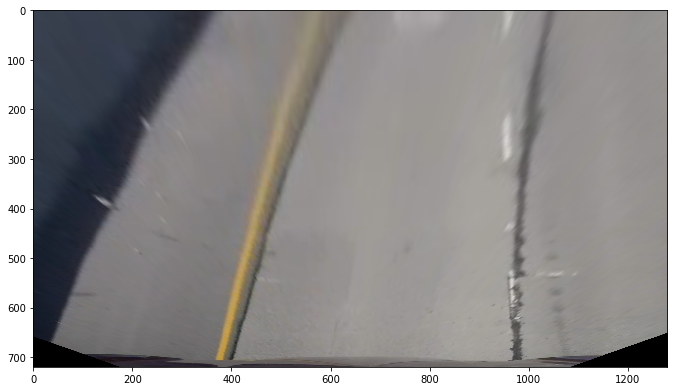

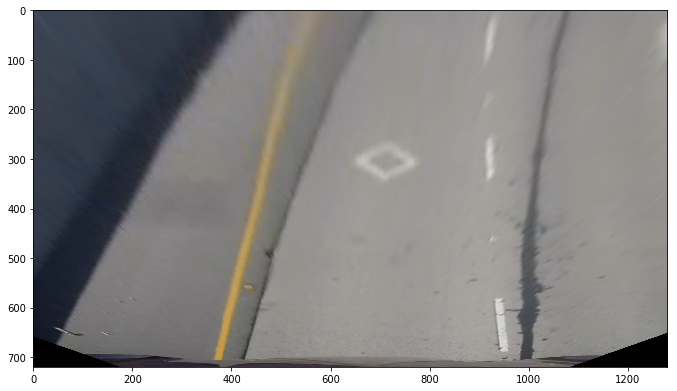

...

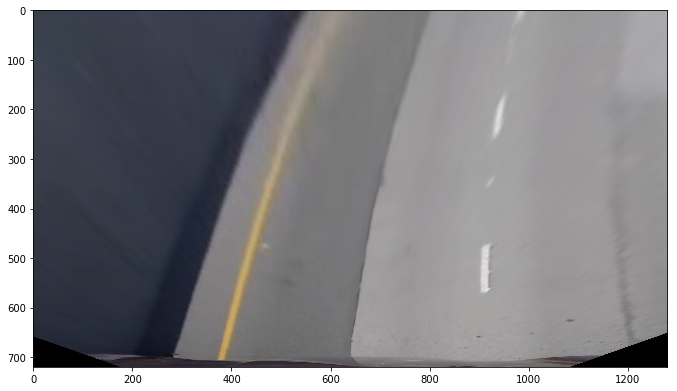

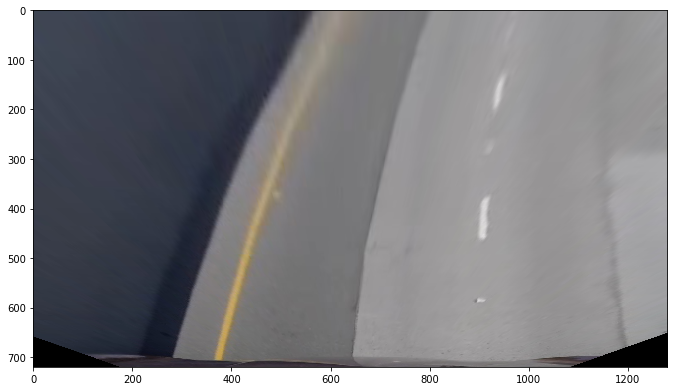

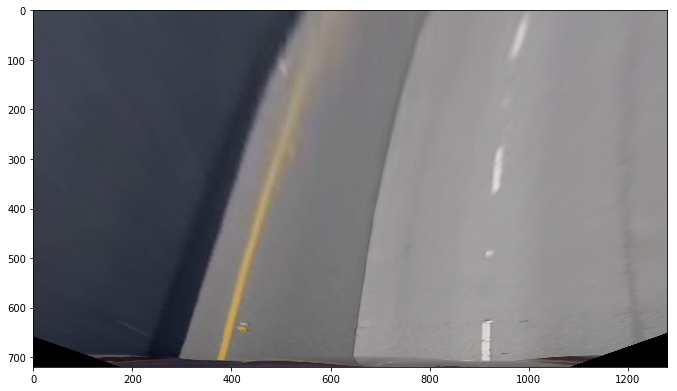

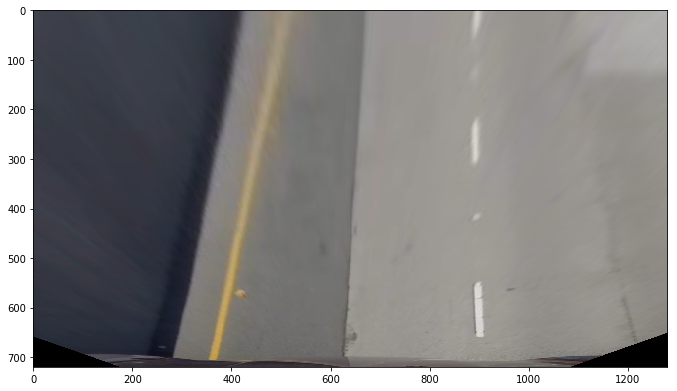

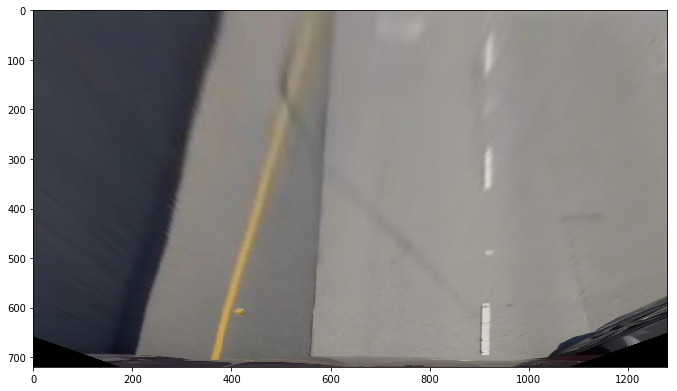

In [53]:
#Select an image to transform. This image was chosen as the lanes are approximately vertically symmertical
#along the y-axis

image = mpimg.imread('test_images/straight_lines1.jpg')
undistorted = undistort_image(image)
image_size_x = image.shape[1]
image_size_y = image.shape[0]

#The source points were calcuated by adjusting the trapezium into the shape and position shown below
src_img = [
    (200., image_size_y), # left, bottom
    (562., 475.), # left, top
    (725., 475.), # right, top
    (1110., image_size_y), # right, bottom
    (200., image_size_y), # ignored
    ]

codes = [Path.MOVETO,
         Path.LINETO,
         Path.LINETO,
         Path.LINETO,
         Path.CLOSEPOLY,
         ]

path = Path(src_img, codes)

#Display the trapezium on the image and ensure it aligns paralelly with the left lane the right lane 
#and that it covers the area between the lanes. 

#Note: The lanes in the image selected are very slightly curved to the right.
#In order to accomodate for this, the left lane slightly enters into the trapezium towards the top and
#the right lane slightly exits the trapezium towards the top.

fig = plt.figure(figsize = (25,25))
ax1 = fig.add_subplot(1,2,1)
ax1.set_title('Image with Trapezium', fontsize = 24)
ax1.imshow(undistorted)

patch = patches.PathPatch(path,  lw=2)
ax1.add_patch(patch)

#Based on src_img, the src array is populated.
_src = np.float32(
   [[562., 475.], # left, top
    [200., image_size_y], # left, bottom
    [1110., image_size_y], # right, bottom
    [725., 475.]])# right, top    

#The destination array shows the positions of the left and right lanes on a straight road with birds eye view.
_dst = np.float32(
    [[(image_size_x / 4), 0],
    [(image_size_x / 4), image_size_y],
    [(image_size_x * 3 / 4), image_size_y],
    [(image_size_x * 3 / 4), 0]])

#transform matrix takes the source and destination arrays and outputs the transformation matrix and its inverse.
#the Inverse matrix can be used to go back from the top view to side view.
def transform_matrix( src = _src, dst = _dst):
    
    M = cv2.getPerspectiveTransform(_src, _dst)
    Minv = cv2.getPerspectiveTransform(_dst, _src)

    return M, Minv

#Generate M and Minv values that will be used throughout 
M, Minv = transform_matrix( src = _src, dst = _dst)

#Split image into one with just Hue, one with just Lightness and one with just Saturation
def hls_split (img):
    
    # Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    
    return h_channel, l_channel, s_channel


#perspective_trans takes in an image and outputs the perspective transform of it
def perspective_trans(image, M, image_size = (image_size_x, image_size_y)):
    
    warped_image = cv2.warpPerspective(image, M, image_size, flags = cv2.INTER_LINEAR)
    
    return warped_image

#Compute and display perspective transform for all test images
pers_image_test = perspective_trans(image, M)
fig = plt.figure(figsize = (25,25))
ax1 = fig.add_subplot(1,2,1)
ax1.set_title('Perspective Transform on Test Images', fontsize = 24)
ax1.imshow(pers_image_test)


for file in test_images:
    
    image = mpimg.imread(file)
    pers_image_test = perspective_trans(image, M)
    
    #h_channel, l_channel, s_channel = hls_split(pers_image_test)
    fig = plt.figure(figsize = (25,25))
    ax1 = fig.add_subplot(1,2,1)
    ax1.imshow(pers_image_test)

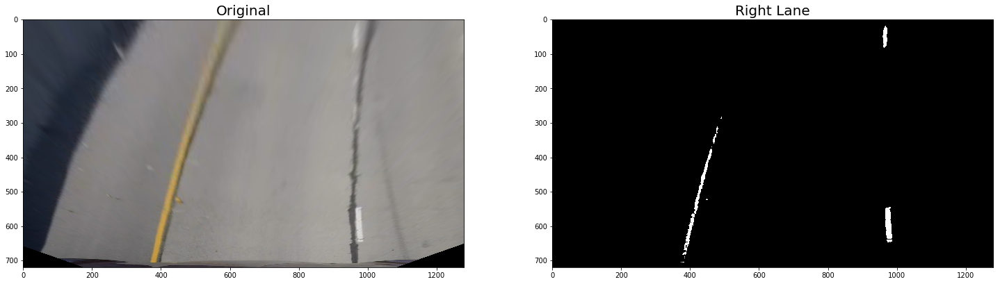

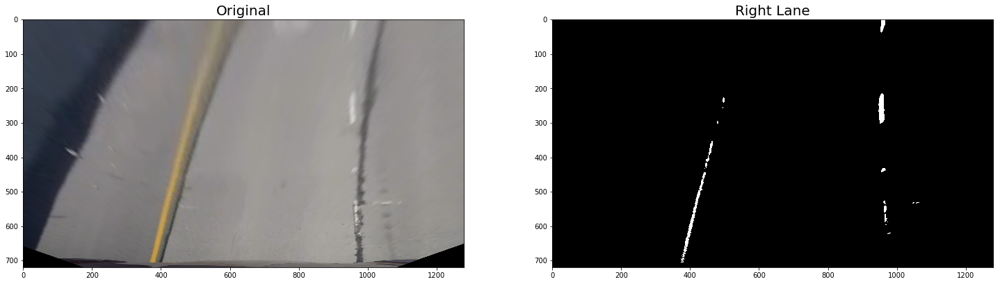

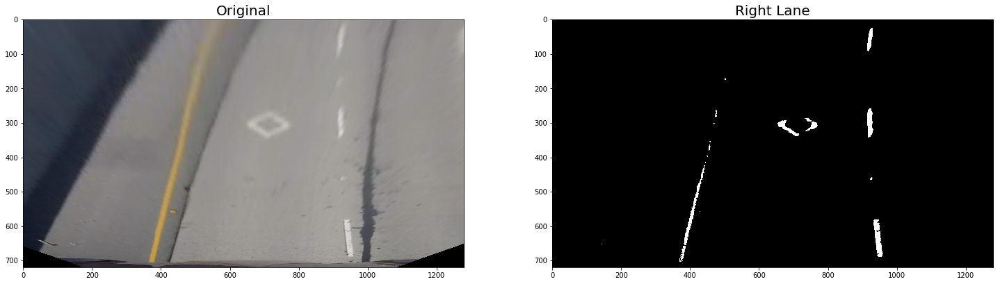

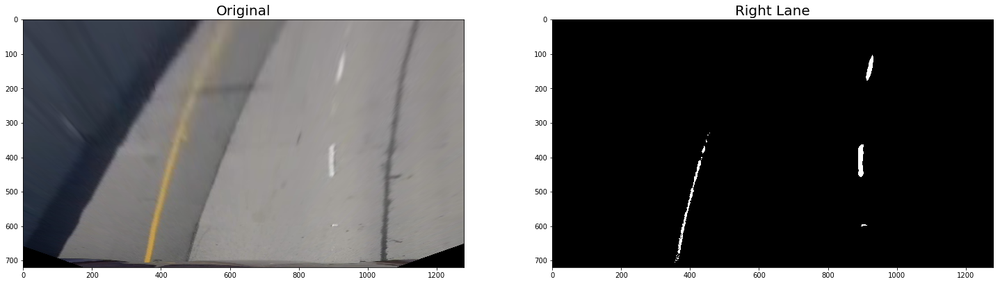

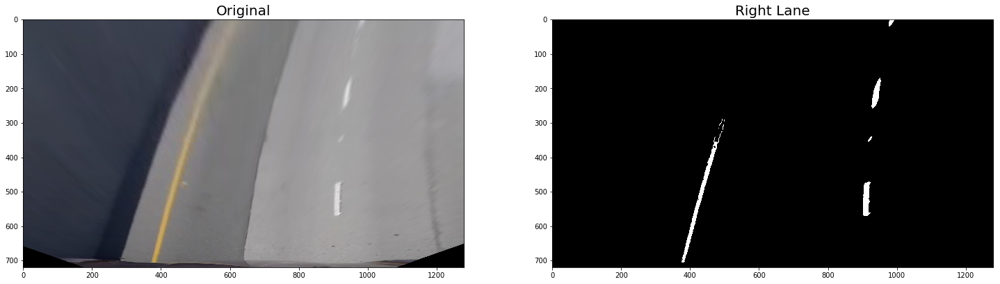

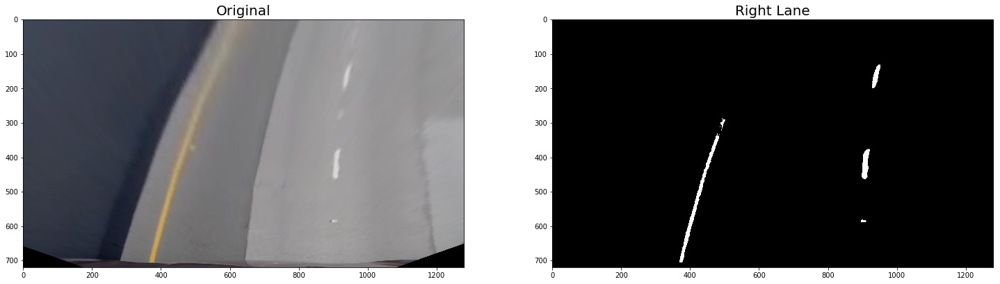

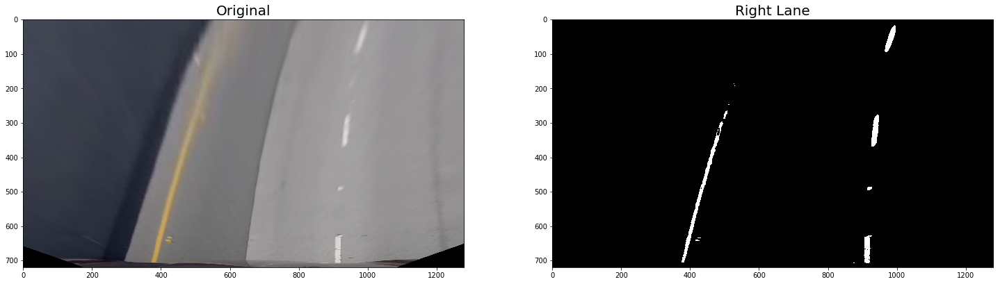

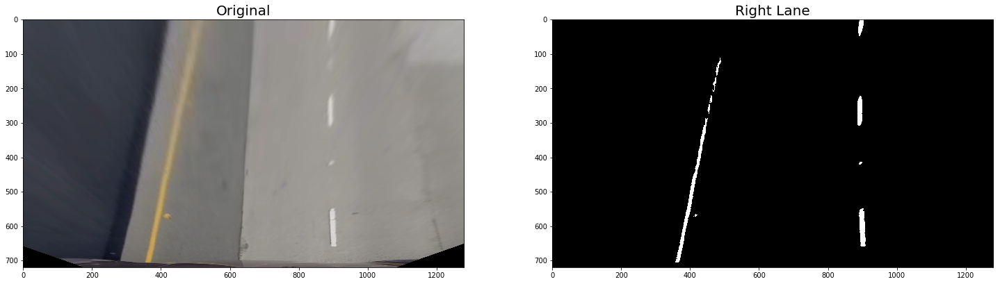

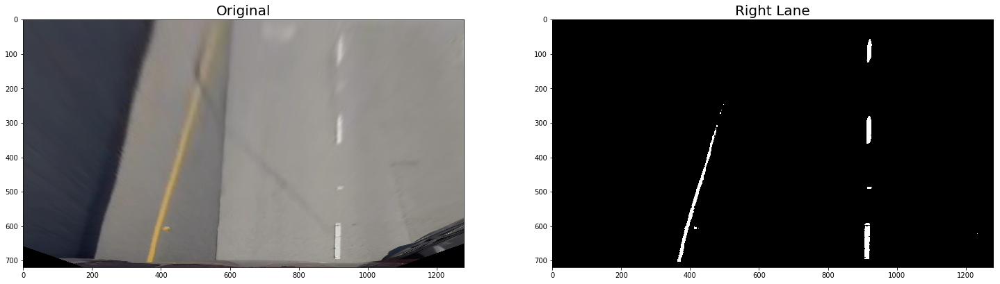

In [54]:
def convert2Dto3D(image_2d):
    
    image_3d = np.dstack((image_2d, image_2d, image_2d))   
    
    return image_3d

def yellow_filter(image):
        
    #lower_limit = np.array([153, 153, 0])
    lower_limit = np.array([100, 153, 0])
    upper_limit = np.array([255, 255, 130])
    result_image = cv2.inRange(image, lower_limit, upper_limit)
    
    return result_image

def white_filter(image):
    h_channel, l_channel, s_channel = hls_split(image)
    l_image = convert2Dto3D(l_channel)
    
    lower_limit = np.array([215, 215, 215])
    upper_limit = np.array([255, 255, 255])
    result_image = cv2.inRange(l_image, lower_limit, upper_limit)
    
    return result_image

def hls_l_filter(image):
    h_channel, l_channel, s_channel = hls_split(image)
    l_image = convert2Dto3D(l_channel)
    
    lower_limit = np.array([180, 180, 180])
    upper_limit = np.array([255, 255, 255])
    result_image = cv2.inRange(l_image, lower_limit, upper_limit)
    
    return result_image

def hls_s_filter(image):
    h_channel, l_channel, s_channel = hls_split(image)
    s_image = convert2Dto3D(s_channel)
    lower_limit = np.array([110, 110, 110])
    upper_limit = np.array([255, 255, 255])
    result_image = cv2.inRange(s_image, lower_limit, upper_limit)
    
    return result_image

def combine_filters(image):
    yellow_mask = yellow_filter(image)
    white_mask = white_filter(image)
    hls_l_mask = hls_l_filter(image)
    hls_s_mask = hls_s_filter(image)
    combined_image1 = cv2.bitwise_or(yellow_mask, white_mask)
    combined_image2 = cv2.bitwise_or(combined_image1, hls_l_mask)
    #combined_image3 = cv2.bitwise_or(combined_image1, combined_image2)
    return combined_image2

for file in test_images:
    
    image = mpimg.imread(file)
    pers_image_test = perspective_trans(image, M)
    filtered_image = combine_filters(pers_image_test)
        
    fig = plt.figure(figsize = (25,25))
    ax1 = fig.add_subplot(1,2,1)
    ax1.imshow(pers_image_test)
    ax1.set_title('Original', fontsize = 20)
    ax2 = fig.add_subplot(1,2,2)
    ax2.imshow(filtered_image, cmap = 'gray')
    ax2.set_title('Right Lane', fontsize = 20)

    

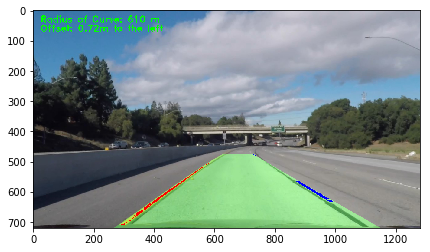

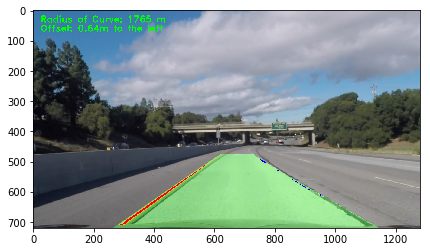

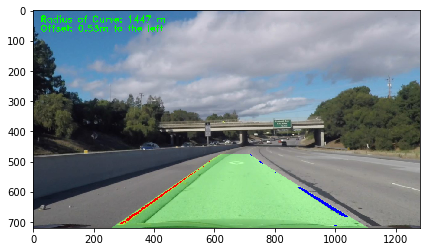

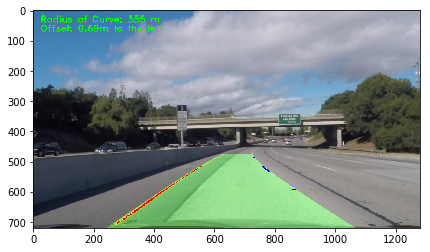

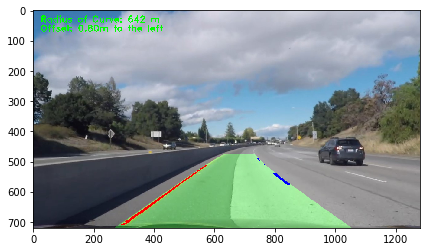

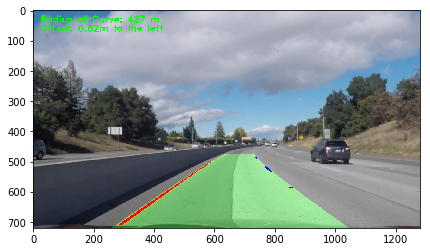

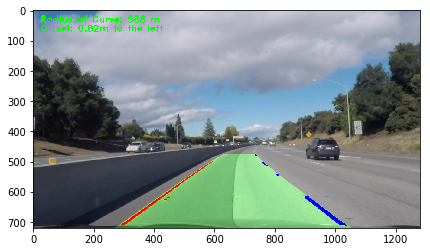

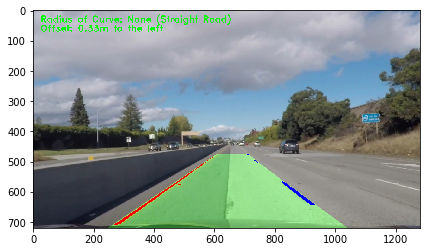

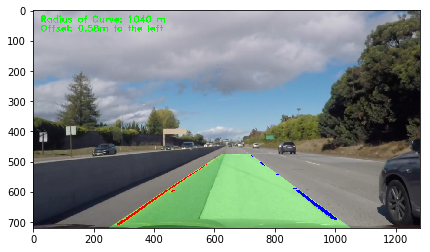

In [55]:
import math

"""In order to create a smooth transition between frames we create a
    buffers to store static values of the previous frames
"""

class buffers_collection(object):
    
    def __init__(self):
    
        #left polynomial coefficients
        self.left_fit = []

        #right polynomail coefficients
        self.right_fit = []
        
        #left curve polynomial coeffecients
        self.left_fit_cr = []
        
        #right curve polynomial coeffecients
        self.right_fit_cr = []
        
        #distance between left and right lanes.
        self.separation = []
        
        #distance between center of car and center of lane
        self.offset = []
        
        #radius of curvature
        self.radius = []
        
        #coordinates
        self.leftx = []
        
        self.lefty = []
        
        self.rightx = []

        self.righty = []
        
    #clear buffers before starting of a video
    def clear_buffers(self):

        self.left_fit = []
        self.right_fit = []
        self.left_fit_cr = []
        self.right_fit_cr = []
        self.separation = []
        self.offset = []
        self.radius = []
        self.leftx = []
        self.lefty = []
        self.rightx = []
        self.righty = []
        
buffers = buffers_collection()

"""
In either buffer_lines or buffer_coord, we add elements to the buffer
until the buffer exceeds value of listSize. Then, we omit the oldest values
as new values are inserted into the buffer.
buffer_lines is for single variable values i.e. gradient m and y-intercept c
buffer_coord is for coordinates .i.e. x1, y1, x2, y2 values.

"""
def buffer_lines(listofvalues, element, listSize):
    
    if (len(listofvalues) >= listSize):
        listofvalues.pop(0)
    
    listofvalues.extend([element])

    return listofvalues


def buffer_lines_coords(listofvalues, element, listSize):
    
    if (len(listofvalues) >= listSize):
        listofvalues.pop(0)
    
    listofvalues.extend(element)

    return listofvalues
#Split image into one with just Hue, one with just Lightness and one with just Saturation
def hls_split (img):
    
    # Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    
    return h_channel, l_channel, s_channel

#Take sobel derivative setting the kernel to 5
def sobel(img, mag_thresh, sobel_kernel=5):

    # x derivative
    _sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize = sobel_kernel)

    # y derivative
    _sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize = sobel_kernel)

    _absSobel = np.sqrt(_sobelx**2 + _sobely**2)
    _scaleSobel = np.uint8(255*_absSobel/np.max(_absSobel))

    
    _sobelBinary = np.zeros_like(_scaleSobel)
    _sobelBinary[(_scaleSobel >= mag_thresh[0]) & (_scaleSobel < mag_thresh[1])] = 1
    
    return _sobelBinary


#Take directional gradient for sobel
def grad_dir(img, dir_thresh, sobel_kernel=5):
    
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # x derivative
    _sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)

    # y derivative
    _sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)

    _abs_x = np.absolute(_sobelx)
    _abs_y = np.absolute(_sobely)
    
    _dir = np.arctan2(_abs_y, _abs_x)
    
    binary_dir = np.zeros_like(gray)
    binary_dir[(_dir > dir_thresh[0]) & (_dir < dir_thresh[1])] = 1
    
    return binary_dir
    
#Take color gradient of image given the threshold
def grad_color(img, thresh):
    
    binary = np.zeros_like(img)
    
    binary[(img > thresh[0]) & (img <= thresh[1])] = 1
    
    return binary

#image_cropper crops out the unwated areas outside of an image when looking for lanes.
#Note: Sometimes cars passing in adjacent lanes can confuse the program to consider the car as lane lines.
#image_cropper ensures that these cars are ignored.
def image_cropper(image):
    
    image[:,int(image.shape[1]*0.80):] = 0
    image[:,:int(image.shape[1]*0.20)] = 0
    return image

#hist plots a histogram of the lower half region of the image.
def hist(binary_warped):
    
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    #histogram = np.sum(binary_warped[:,:], axis=0)
    return histogram

"""
NOTE: smooth_hist and find_peaks are not used in this implementation
"""
#smooth_hist is a histogram curve with the gausian filter applied to it.
def smooth_hist(binary_warped):
    
    #histogram = np.sum(binary_warped[int(binary_warped.shape[0]):,:], axis=0)
    histogram = np.sum(binary_warped[:,:], axis=0)
    smooth_histogram = gaussian_filter1d(histogram, 10)
    return smooth_histogram

#find_peaks finds peaks for the smooth histogram
def find_peaks(smooth_histogram):
    
    peakind = signal.find_peaks_cwt(smooth_histogram, np.arange(1, smooth_histogram.shape[0]) )
    return peakind


#lane_coordinates returns 2 pairs of arrays. Each pair of coordinates has the x and y coordinates of the lane line.
#The sliding windows technique is used here.
def lane_coordinates (image, image_strips, histogram, window_width, min_pixels):
    
    #out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    image_height = image.shape[0]

    #------------------------------------
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    left_peak = np.argmax(histogram[:midpoint])
    right_peak = np.argmax(histogram[midpoint:]) + midpoint

    #print(left_peak, right_peak)
    # Set height of windows
    strip_height = np.int(image_height/image_strips)

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = image.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    left_lane_index = []
    right_lane_index = []
        
    for strip in range(image_strips):
        
        #One window will slide in each stirp
        strip_bottom = image_height - (strip + 1)*strip_height
        strip_top = image_height - strip*strip_height
        
        #There will be two lanes in each strip: the left lane and right lane
        left_lane_window_low = left_peak - window_width
        left_lane_window_high = left_peak + window_width
        
        right_lane_window_low = right_peak - window_width
        right_lane_window_high = right_peak + window_width
        
        # Identify the nonzero pixels in x and y within the window
        good_left_index = ((nonzeroy >= strip_bottom) & (nonzeroy < strip_top) & (nonzerox >= left_lane_window_low) & (nonzerox < left_lane_window_high)).nonzero()[0]
        good_right_index = ((nonzeroy >= strip_bottom) & (nonzeroy < strip_top) & (nonzerox >= right_lane_window_low) & (nonzerox < right_lane_window_high)).nonzero()[0]
        
        left_lane_index.append(good_left_index)
        right_lane_index.append(good_right_index)
        
        if (len(good_left_index) > min_pixels):
            left_peak = np.int(np.mean(nonzerox[good_left_index]))
        
        if (len(good_right_index) > min_pixels):
            right_peak = np.int(np.mean(nonzerox[good_right_index]))
    

    left_lane_index = np.concatenate(left_lane_index)
    right_lane_index = np.concatenate(right_lane_index)
        
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_index]
    lefty = nonzeroy[left_lane_index] 
    rightx = nonzerox[right_lane_index]
    righty = nonzeroy[right_lane_index]
    
    if (len(leftx) > 0):
        #buffers.leftx = buffer_lines_coords(buffers.leftx, leftx, 1)
        #buffers.lefty = buffer_lines_coords(buffers.lefty, lefty, 1)
        
        buffers.leftx = leftx
        buffers.lefty = lefty
        
    if (len(rightx) > 0):
        #buffers.rightx = buffer_lines_coords(buffers.rightx, rightx, 1)
        #buffers.righty = buffer_lines_coords(buffers.righty, righty, 1)
        
        buffers.rightx = rightx
        buffers.righty = righty
        
    else:
        leftx = buffers.leftx
        lefty = buffers.lefty 
        rightx = buffers.rightx
        righty = buffers.righty

    return buffers.leftx, buffers.lefty, buffers.rightx, buffers.righty

#returns percentage difference between two values
def percentage_diff(val1, val2):
    
    return float(abs(val1 - val2)/((val1 + val2)/2))

#returns the average seperation between the left and right lane lines
def lane_separation(leftx, rightx):
    
    separation = abs(leftx.mean() - rightx.mean())
    
    #print(separation)
    return separation

def lane_adjustment(image, leftx, lefty, rightx, righty, minimum_percent = 15):
    separation_listSize = 100
    
    try:
        separation = int(lane_separation(leftx, rightx))
    except:
        
        if (math.isnan(np.mean(buffers.separation))):
            
            separation = 700
            
        else:
            
            separation = np.mean(buffers.separation)

    if not buffers.separation:
        buffers.separation = buffer_lines(buffers.separation, separation, separation_listSize)
    
    separation_mean = int(np.mean(buffers.separation))
    
    if (abs(percentage_diff(separation, separation_mean)) <  0.05):
    
        buffers.separation = buffer_lines(buffers.separation, separation, separation_listSize)
        
        separation_mean = int(np.mean(buffers.separation))

    minimum_percent_dec = float(minimum_percent/100)
    
    if (len(leftx) < (minimum_percent_dec * len(rightx))):
        try:
            adjusted_leftx = rightx - separation_mean
        except:
            print('rightx value is ', rightx[0])
            print('rightx', len(rightx), rightx)
            print('separation_mean', separation_mean)
        adjusted_lefty = righty
        adjusted_rightx = rightx
        adjusted_righty = righty
    
    elif (len(rightx) < (minimum_percent_dec * len(leftx))):
        adjusted_leftx = leftx 
        adjusted_lefty = lefty
        try:
            adjusted_rightx = leftx + separation_mean
        except:
            print('left value is ', leftx[0])
            print('leftx', len(leftx), leftx)
            print('separation_mean', separation_mean)
        adjusted_righty = lefty

    else:
        adjusted_leftx = leftx 
        adjusted_lefty = lefty
        adjusted_rightx = rightx
        adjusted_righty = righty
    
    for i in range(len(adjusted_rightx)):
        adjusted_rightx[i] = min(adjusted_rightx[i], (image.shape[1] - 1))
        
    for i in range(len(adjusted_leftx)):
        adjusted_leftx[i] = max(adjusted_leftx[i], 0)
        
    return adjusted_leftx, adjusted_lefty, adjusted_rightx, adjusted_righty





def coefficient_adjustment(coeff, cap):
    
    if (coeff > 0):
        new_coeff = min(coeff, cap)
    else:
        new_coeff = max(coeff, -cap)
    
    return new_coeff

def polynomial_adjustment(fit):
    
    new_fit = fit[:]
    
    new_fit[0] = coefficient_adjustment(fit[0], 0.0010)
    new_fit[1] = coefficient_adjustment(fit[1], 1.0)
    new_fit[2] = coefficient_adjustment(fit[2], 1500)
    
    return new_fit
    
#Create polynomials for each lane line given x and y coordianes.
def lane_polynomial(image, leftx, lefty, rightx, righty):
    
    try:
        # Fit a second order polynomial to each
        left_fit_raw = np.polyfit(lefty, leftx, 2)
        right_fit_raw = np.polyfit(righty, rightx, 2)
    except:
        left_fit_raw = np.mean(buffers.left_fit, axis = 0)
        right_fit_raw = np.mean(buffers.right_fit, axis = 0)
    
    left_fit = polynomial_adjustment(left_fit_raw)
    right_fit = polynomial_adjustment(right_fit_raw)
    
    #store left and right values into buffer
    buffers.left_fit = buffer_lines(buffers.left_fit, left_fit, listSize = 10)
    buffers.right_fit = buffer_lines(buffers.right_fit, right_fit, listSize = 10)

    # Generate x and y values for plotting
    ploty = np.linspace(0, image.shape[0]-1, image.shape[0] )
    left_fitx = np.mean(buffers.left_fit, axis = 0)[0]*ploty**2 + np.mean(buffers.left_fit, axis = 0)[1]*ploty + np.mean(buffers.left_fit, axis = 0)[2]
    right_fitx = np.mean(buffers.right_fit, axis = 0)[0]*ploty**2 + np.mean(buffers.right_fit, axis = 0)[1]*ploty + np.mean(buffers.right_fit, axis = 0)[2]

    return right_fitx, left_fitx, ploty, left_fit, right_fit

#calculate radius of curve given the coordinates of the left and right lane lines
def radius_of_curve(leftx, lefty, rightx, righty):

    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    y_left_eval = np.max(lefty)
    y_right_eval = np.max(righty)

    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 20/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    try:
        # Fit new polynomials to x,y in world space
        left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
        
    except:
        
        left_fit_cr = np.mean(buffers.left_fit_cr, axis = 0)
        right_fit_cr = np.mean(buffers.right_fit_cr, axis = 0)
    
    #Store left_fit and right_fit into buffers
    buffers.left_fit_cr = buffer_lines(buffers.left_fit_cr, left_fit_cr, listSize = 50)
    buffers.right_fit_cr = buffer_lines(buffers.right_fit_cr, right_fit_cr, listSize = 50)
    
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*np.mean(buffers.left_fit_cr, axis = 0)[0]*y_left_eval*ym_per_pix + np.mean(buffers.left_fit_cr, axis = 0)[1])**2)**1.5) / np.absolute(2*np.mean(buffers.left_fit_cr, axis = 0)[0])
    right_curverad = ((1 + (2*np.mean(buffers.right_fit_cr, axis = 0)[0]*y_right_eval*ym_per_pix + np.mean(buffers.right_fit_cr, axis = 0)[1])**2)**1.5) / np.absolute(2*np.mean(buffers.right_fit_cr, axis = 0)[0])
    
    left_curverad = ((1 + (2*np.mean(buffers.left_fit_cr, axis = 0)[0]*y_left_eval*ym_per_pix + np.mean(buffers.left_fit_cr, axis = 0)[1])**2)**1.5) / np.absolute(2*np.mean(buffers.left_fit_cr, axis = 0)[0])
    right_curverad = ((1 + (2*np.mean(buffers.right_fit_cr, axis = 0)[0]*y_right_eval*ym_per_pix + np.mean(buffers.right_fit_cr, axis = 0)[1])**2)**1.5) / np.absolute(2*np.mean(buffers.right_fit_cr, axis = 0)[0])
    
    #limit the radius of curvature max value to 2000. Beyond this, the lane can be assumed to be a straight line.
    left_curverad = min(left_curverad, 2000)
    right_curverad = min(right_curverad, 2000)
    
    return left_curverad, right_curverad

#unwarp the lane lines and put them on the original image
def highlight_lane(warped_image, right_fitx, left_fitx, ploty, leftx, lefty, rightx, righty):
    
    
    #--------------------------Fill polynomail between left and right lines----------------------------

    # Create an image to draw the lines on
    lane_zero = np.zeros_like(warped_image).astype(np.uint8)
    
    lane_warp = convert2Dto3D(lane_zero)
 
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx -  10, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx + 10, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(lane_warp, np.int_([pts]), (0,255, 0))
    
    #Color the left right right lane lines so that they are clearly visible
    #line_warp[lefty, leftx] = [128,0,0]
    #line_warp[righty, rightx] = [0,0,128]
    
    return lane_warp

def unwarp_image(image, undist):
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    unwarped_image = cv2.warpPerspective(image, Minv, (undist.shape[1], undist.shape[0]))
    
    return unwarped_image

def combine_images(image1, image2):
    # Combine the result with the original image
    combined_image = cv2.addWeighted(image1,  1, image2, 0.3, 0)    

    #plt.imshow(result)
    return combined_image


def highlight_lane_lines(warped_image, undist, right_fitx, left_fitx, ploty, leftx, lefty, rightx, righty):
    
    #-------------------Highlight the left and right lines-------------------
    # Create an image to draw the lines on
    lane_zero = np.zeros_like(warped_image).astype(np.uint8)
    line_zero = np.zeros_like(warped_image).astype(np.uint8)
    
    lane_warp = convert2Dto3D(lane_zero)
    line_warp = convert2Dto3D(line_zero)
    
    # Create an image to draw the lines on
    #lane_zero = np.zeros_like(warped_image).astype(np.uint8)
    left_line_zero = np.zeros_like(warped_image).astype(np.uint8)
    
    #lane_warp = np.dstack((lane_zero, lane_zero, lane_zero))
    left_line_warp = convert2Dto3D(line_zero)
    right_line_warp = convert2Dto3D(line_zero)

    left_line_warp[lefty, leftx] = [255,0,0]
    right_line_warp[righty, rightx] = [0,0,255]  
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    unwarp_left_line = unwarp_image(left_line_warp, undist)
    unwarp_right_line = unwarp_image(right_line_warp, undist)
    
    # Identify the x and y positions of all nonzero pixels in the image
    left_nonzero = unwarp_left_line.nonzero()
    left_nonzeroy = np.array(left_nonzero[0])
    left_nonzerox = np.array(left_nonzero[1])

    # Identify the x and y positions of all nonzero pixels in the image
    right_nonzero = unwarp_right_line.nonzero()
    right_nonzeroy = np.array(right_nonzero[0])
    right_nonzerox = np.array(right_nonzero[1])
    
    line_image = np.copy(undist)
    #line_image = cv2.addWeighted(undist, 1, unwarp_line_image, 2.6, 0)
    line_image[left_nonzeroy, left_nonzerox] = [255,0,0]
    line_image[right_nonzeroy, right_nonzerox] = [0,0,255]
    
    return line_image

def highlight_lane_lines_top_view(warped_image, undist, right_fitx, left_fitx, ploty, leftx, lefty, rightx, righty):
    
    #-------------------Highlight the left and right lines-------------------
    # Create an image to draw the lines on
    lane_zero = np.zeros_like(warped_image).astype(np.uint8)
    line_zero = np.zeros_like(warped_image).astype(np.uint8)
    
    lane_warp = convert2Dto3D(lane_zero)
    line_warp =convert2Dto3D(line_zero)
    
    # Create an image to draw the lines on
    #lane_zero = np.zeros_like(warped_image).astype(np.uint8)
    left_line_zero = np.zeros_like(warped_image).astype(np.uint8)
    
    #lane_warp = np.dstack((lane_zero, lane_zero, lane_zero))
    left_line_warp = convert2Dto3D(line_zero)
    right_line_warp = convert2Dto3D(line_zero)

    left_line_warp[lefty, leftx] = [255,0,0]
    right_line_warp[righty, rightx] = [0,0,255]  
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    #unwarp_left_line = unwarp_image(left_line_warp, undist)
    #unwarp_right_line = unwarp_image(right_line_warp, undist)
    
    # Identify the x and y positions of all nonzero pixels in the image
    left_nonzero = left_line_warp.nonzero()
    left_nonzeroy = np.array(left_nonzero[0])
    left_nonzerox = np.array(left_nonzero[1])

    # Identify the x and y positions of all nonzero pixels in the image
    right_nonzero = right_line_warp.nonzero()
    right_nonzeroy = np.array(right_nonzero[0])
    right_nonzerox = np.array(right_nonzero[1])
    
    line_image = np.copy(undist)
    #line_image = cv2.addWeighted(undist, 1, unwarp_line_image, 2.6, 0)
    line_image[left_nonzeroy, left_nonzerox] = [255,0,0]
    line_image[right_nonzeroy, right_nonzerox] = [0,0,255]
    
    return line_image



def get_offset(image, right_fit_bottom, left_fit_bottom):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 20/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    image_height = image.shape[0]
    image_width = image.shape[1]
    center_of_image = int(image_width/2)

    #center of lane in pixels
    center_of_lane_px = (right_fit_bottom + left_fit_bottom)/2.0
    
    #offset in pixels
    offset_px = (image_width/2.0) - center_of_lane_px
    
    #offset in meters
    offset_m = offset_px*xm_per_pix
    buffers.offset = buffer_lines(buffers.offset, offset_m, listSize = 10)
    
    return np.mean(buffers.offset)

def add_text(image, radius, offset):
    
    
    if (np.mean(radius) < 2000):
        radius_text = 'Radius of Curve: ' + str(int(np.mean(radius))) + ' m'
    else:
        radius_text = 'Radius of Curve: None (Straight Road)'
    
    radius_image = cv2.putText(img=np.copy(image), 
                               text = radius_text, org=(25, 40),
                               fontFace=2, fontScale=1, color=(0,255,0), thickness=2)
    
    if (offset < 0):
        offset_text = 'Offset: ' + str(format(abs(np.mean(offset)),'.2f')) + 'm to the left'
    
    else:
        offset_text = 'Offset: ' + str(format(abs(np.mean(offset)),'.2f')) + 'm to the right'

    offset_image = cv2.putText(img=np.copy(radius_image), 
                               text = offset_text, org=(25, 70),
                               fontFace=2, fontScale=1, color=(0,255,0), thickness=2)
    return offset_image
    
#The Overall pipeline that will take in the original image and return it with the lane highlighted and
#the radius of curvature mentioned on top of the video
def pipeline(image, s_thresh=(160, 220), mag_thresh=(40,160), dir_thresh = (0.9, 1.3)):
    
    undistorted = undistort_image(image)
    p_trans = perspective_trans(undistorted, M)
    
    """
    
    v_channel, l_channel, s_channel = hls_split(p_trans)
    
    s_sobel = sobel(s_channel, mag_thresh)
    s_color = grad_color(s_channel,  s_thresh)

    s_dir = grad_dir(undistorted, dir_thresh)
    combined_color_sobel = np.zeros_like(s_dir)
    combined_sobel_dir = np.zeros_like(s_dir)
    
    combined_color_sobel[(s_color == 1) | (s_sobel == 1)] = 1
    combined_sobel_dir[(s_color == 1) & (s_dir == 1) ] = 1
    
    combined_filters = combine_filters(p_trans)

    binary_warped = np.zeros_like(s_dir)
    binary_warped[(combined_color_sobel == 1) | (combined_sobel_dir == 1) | (combined_filters == 1)] = 1
    
    
    """


    binary_warped = combine_filters(p_trans)
    
    #cropped_image = image_cropper(binary_warped)
    
    histogram = hist(binary_warped)

    leftx, lefty, rightx, righty = lane_coordinates(binary_warped, 18, histogram, 50, 100)

    adjusted_leftx, adjusted_lefty, adjusted_rightx, adjusted_righty = lane_adjustment(image, leftx, lefty, rightx, righty)
    
    right_fitx, left_fitx, ploty, left_fit, right_fit = lane_polynomial(binary_warped, adjusted_leftx, adjusted_lefty, adjusted_rightx, adjusted_righty)

    offset = get_offset(image, right_fitx[0], left_fitx[0])
    
    left_curverad, right_curverad = radius_of_curve(adjusted_leftx, adjusted_lefty, adjusted_rightx, adjusted_righty)
        
    lane_image = highlight_lane(binary_warped, right_fitx, left_fitx, ploty, leftx, lefty, rightx, righty)
    
    unwarped_image = unwarp_image(lane_image, undistorted)
    
    combined_image = combine_images(undistorted, unwarped_image)
    
    colored_image = highlight_lane_lines(binary_warped, combined_image, right_fitx, left_fitx, ploty, leftx, lefty, rightx, righty)
    
    
    buffers.radius = buffer_lines(buffers.radius, left_curverad, listSize = 10)
    
    texted_image = add_text(colored_image, buffers.radius, offset)
    
    return texted_image

#The Overall pipeline that will take in the original image and return it with the lane highlighted and
#the radius of curvature mentioned on top of the video
def pipeline_topview(image, s_thresh=(160, 220), mag_thresh=(40,160), dir_thresh = (0.9, 1.3)):
    
    undistorted = undistort_image(image)
    p_trans = perspective_trans(undistorted, M)
    
    """
    
    v_channel, l_channel, s_channel = hls_split(p_trans)
    
    s_sobel = sobel(s_channel, mag_thresh)
    s_color = grad_color(s_channel,  s_thresh)

    s_dir = grad_dir(undistorted, dir_thresh)
    combined_color_sobel = np.zeros_like(s_dir)
    combined_sobel_dir = np.zeros_like(s_dir)
    
    combined_color_sobel[(s_color == 1) | (s_sobel == 1)] = 1
    combined_sobel_dir[(s_color == 1) & (s_dir == 1) ] = 1
    
    combined_filters = combine_filters(p_trans)

    binary_warped = np.zeros_like(s_dir)
    binary_warped[(combined_color_sobel == 1) | (combined_sobel_dir == 1) | (combined_filters == 1)] = 1
    
    
    """


    binary_warped = combine_filters(p_trans)
    
    #cropped_image = image_cropper(binary_warped)
    
    histogram = hist(binary_warped)

    leftx, lefty, rightx, righty = lane_coordinates(binary_warped, 18, histogram, 50, 100)

    adjusted_leftx, adjusted_lefty, adjusted_rightx, adjusted_righty = lane_adjustment(image, leftx, lefty, rightx, righty)
    
    right_fitx, left_fitx, ploty, left_fit, right_fit = lane_polynomial(binary_warped, adjusted_leftx, adjusted_lefty, adjusted_rightx, adjusted_righty)

    offset = get_offset(image, right_fitx[0], left_fitx[0])
    
    left_curverad, right_curverad = radius_of_curve(adjusted_leftx, adjusted_lefty, adjusted_rightx, adjusted_righty)
        
    lane_image = highlight_lane(binary_warped, right_fitx, left_fitx, ploty, leftx, lefty, rightx, righty)
    
    #unwarped_image = unwarp_image(lane_image, undistorted)
    
    combined_image = combine_images(p_trans, lane_image)
    
    colored_image = highlight_lane_lines_top_view(binary_warped, combined_image, right_fitx, left_fitx, ploty, leftx, lefty, rightx, righty)
    
    
    buffers.radius = buffer_lines(buffers.radius, left_curverad, listSize = 10)
    
    texted_image = add_text(colored_image, buffers.radius, offset)
    
    return texted_image

#The Overall pipeline that will take in the original image and return it with the lane highlighted and
#the radius of curvature mentioned on top of the video
def pipeline_topview_binary(image, s_thresh=(160, 220), mag_thresh=(40,160), dir_thresh = (0.9, 1.3)):
    
    undistorted = undistort_image(image)
    p_trans = perspective_trans(undistorted, M)
    
    binary_warped = combine_filters(p_trans)
    
    result_image = convert2Dto3D(binary_warped)
    
    return result_image

#test pipeline on test images
for file in test_images:
    buffers.clear_buffers()
    image = mpimg.imread(file)
    undistorted = undistort_image(image)
       
    final_image = pipeline(image)

    
    fig = plt.figure(figsize = (20,4))
    ax1 = fig.add_subplot(1,2,1)
    #ax1.plot(smooth_histogram)
    ax1.imshow(final_image)




In [56]:
#Clear the buffer for new road
buffers.clear_buffers()

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

curved_lane_output = 'curvedLaneVideo.mp4'
curved_lane_highlight = VideoFileClip('project_video.mp4')
curved_lane_output_video = curved_lane_highlight.fl_image(pipeline) #NOTE: this function expects color images!!
%time curved_lane_output_video.write_videofile(curved_lane_output, audio=False)

[MoviePy] >>>> Building video curvedLaneVideo.mp4
[MoviePy] Writing video curvedLaneVideo.mp4


100%|█████████▉| 1260/1261 [04:34<00:00,  4.70it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: curvedLaneVideo.mp4 

Wall time: 4min 34s


In [57]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(curved_lane_output))

In [58]:
#Clear the buffer for new road
buffers.clear_buffers()

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

curved_lane_output_topview = 'curvedLaneVideo_topview.mp4'
curved_lane_highlight = VideoFileClip('project_video.mp4')
curved_lane_output_topview_video = curved_lane_highlight.fl_image(pipeline_topview) #NOTE: this function expects color images!!
%time curved_lane_output_topview_video.write_videofile(curved_lane_output_topview, audio=False)

[MoviePy] >>>> Building video curvedLaneVideo_topview.mp4
[MoviePy] Writing video curvedLaneVideo_topview.mp4


100%|█████████▉| 1260/1261 [04:24<00:00,  4.89it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: curvedLaneVideo_topview.mp4 

Wall time: 4min 25s


In [59]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(curved_lane_output_topview))

In [60]:
#Clear the buffer for new road
buffers.clear_buffers()

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

binary_topview_output = 'binary_topview_video.mp4'
binary_topview_highlight = VideoFileClip('project_video.mp4')
binary_topview_output_video = binary_topview_highlight.fl_image(pipeline_topview_binary) #NOTE: this function expects color images!!
%time binary_topview_output_video.write_videofile(binary_topview_output, audio=False)

[MoviePy] >>>> Building video binary_topview_video.mp4
[MoviePy] Writing video binary_topview_video.mp4


100%|█████████▉| 1260/1261 [02:59<00:00,  7.22it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: binary_topview_video.mp4 

Wall time: 2min 59s


In [61]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(binary_topview_output))

In [62]:

#Clear the buffer for new road
buffers.clear_buffers()

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

challenge_output = 'challengeVideo.mp4'
challenge_highlight = VideoFileClip('challenge_video.mp4')
challenge_output_video = challenge_highlight.fl_image(pipeline) #NOTE: this function expects color images!!
%time challenge_output_video.write_videofile(challenge_output, audio=False)

[MoviePy] >>>> Building video challengeVideo.mp4
[MoviePy] Writing video challengeVideo.mp4


100%|██████████| 485/485 [01:43<00:00,  4.70it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challengeVideo.mp4 

Wall time: 1min 43s


In [63]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_output))

In [64]:
#Clear the buffer for new road
buffers.clear_buffers()

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

challenge_topview_binary_output = 'challengeVideo_topview.mp4'
challenge_topview_binary_highlight = VideoFileClip('challenge_video.mp4')
challenge_topview_binary_output_video = challenge_topview_binary_highlight.fl_image(pipeline_topview_binary) #NOTE: this function expects color images!!
%time challenge_topview_binary_output_video.write_videofile(challenge_topview_binary_output, audio=False)

[MoviePy] >>>> Building video challengeVideo_topview.mp4
[MoviePy] Writing video challengeVideo_topview.mp4


100%|██████████| 485/485 [01:08<00:00,  7.18it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challengeVideo_topview.mp4 

Wall time: 1min 8s


In [65]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_topview_binary_output))

In [66]:
#Clear the buffer for new road
buffers.clear_buffers()

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

harder_challenge_output = 'harderChallengeVideo.mp4'
harder_challenge_highlight = VideoFileClip('harder_challenge_video.mp4')
harder_challenge_output_video = harder_challenge_highlight.fl_image(pipeline) #NOTE: this function expects color images!!
%time harder_challenge_output_video.write_videofile(harder_challenge_output, audio=False)

[MoviePy] >>>> Building video harderChallengeVideo.mp4
[MoviePy] Writing video harderChallengeVideo.mp4


100%|█████████▉| 1199/1200 [05:16<00:00,  4.18it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harderChallengeVideo.mp4 

Wall time: 5min 17s


In [67]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(harder_challenge_output))